# Notebook para EDA, Modelagem e segmentação dos clientes

## Problema de negócio

Um dos pontos cruciais do setor de marketing é conhecer os clientes e entender suas necessidades. Entendendo os consumidores podemos enviar campanhas específicas para nescessidades específicas. Se tivermos dados sobre os clientes podemos aplicar ciência de dados para segmentar o mercado. E por isso fui contratado por um banco de New York para analisar os dados e dividir os clientes em grupos para potêncializar a tomada de decisão do time de marketing ao definir campanhas no banco.

## Dicionário de dados

A seguir está o dicionário de dados para o conjunto de dados do cartão de crédito: -

**CUST_ID** : Identificação do Titular do Cartão de Crédito (Categórico)

**BALANCE** : Saldo que resta na conta para fazer compras (

**BALANCE_FREQUENCY** : Com que frequência o Saldo é atualizado, pontuação entre 0 e 1 (1 = atualizado com frequência, 0 = não atualizado com frequência)

**PURCHASES**: Quantidade de compras feitas na conta

**ONEOFF_PURCHASES** : Valor máximo de compra feito de uma só vez

**INSTALLMENTS_PURCHASES** : Valor de compra feito em parcela

**CASH_ADVANCE** : Dinheiro adiantado fornecido pelo usuário

**PURCHASES_FREQUENCY** : Com que frequência as compras estão sendo feitas, pontuação entre 0 e 1 (1 = comprado com frequência, 0 = não comprado com frequência)

**ONEOFF_PURCHASES_FREQUENCY** : Com que frequência as compras estão acontecendo de uma só vez (1 = compradas com frequência, 0 = não compradas com frequência) PURCHASESINSTALLMENTSFREQUENCY : com que

**PURCHASES_INSTALLMENTS_FREQUENCY**as compras parceladas estão sendo feitas (1 = feitas com frequência, 0 = não feitas com frequência)

**CASH_ADVANCE_FREQUENCY** : com que frequência as dinheiro adiantado sendo pago

**CASH_ADVANCE_TRX** : Número de transações feitas com "Cash in Advanced"

**PURCHASES_TRX** : Número de transações de compra feitas

**CREDIT_LIMIT** : Limite de cartão de crédito para o usuário

**PAYMENTS** : Valor do pagamento feito pelo usuário

**MINIMUM_PAYMENTS** : Valor mínimo dos pagamentos feitos pelo usuário

**PRC_FULL_PAYMENT**: Porcentagem do pagamento integral pago pelo usuário

**TENURE**: Posse do serviço de cartão de crédito para o usuário

## Bibliotecas

In [1]:
import pandas as pd
import numpy as np
from sqlalchemy import create_engine, text
import sqlalchemy
import os
from dotenv import load_dotenv
from ydata_profiling import ProfileReport
import plotly.express as px
import plotly.graph_objects as go

from matplotlib import pyplot as plt
%matplotlib inline
import seaborn as sns

from sklearn.model_selection import train_test_split
from sklearn.cluster import KMeans, DBSCAN
from sklearn.metrics import silhouette_score
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.pipeline import Pipeline

from yellowbrick.cluster import KElbowVisualizer

from datetime import datetime
import mlflow
import mlflow.sklearn

import warnings
warnings.filterwarnings('ignore')

In [2]:
import plotly.io as pio
pio.renderers.default = 'vscode'

In [3]:
path_dotenv = r'C:\Users\erico\Documents\projeto-clusterizacao\customer-segmentation\env\.env'
load_dotenv(path_dotenv)

True

## Extração

In [4]:
# criar conexão com MySQL
engine = create_engine('mysql+pymysql://admin:' + os.environ.get("MYSQL_PASSWORD") + '@localhost:3306/Bank_Credit_Card')

In [5]:
query = 'SELECT * FROM customer_credit_card'
df = pd.read_sql_query(sql=text(query), con=engine.connect())

In [6]:
df.head()

,CUST_ID,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,CLUSTER_KMEANS_PCA,SEGMENTATION
0,C15490,8419.740,1.0,3050.48,1475.56,1574.92,2127.49,1.000000,1.000000,1.000000,0.25,5,67,12300.0,3298.74,4239.300,0.000000,12,2,Vip
1,C13195,725.529,1.0,8754.59,8636.73,117.86,0.00,1.000000,1.000000,0.250000,0.00,0,116,4000.0,8648.30,195.873,0.916667,12,2,Vip
2,C13241,292.689,1.0,2815.82,2047.65,768.17,0.00,1.000000,1.000000,1.000000,0.00,0,71,7000.0,4382.77,206.099,0.500000,12,2,Vip
3,C10529,2643.340,1.0,26402.40,22257.40,4145.00,0.00,1.000000,1.000000,0.333333,0.00,0,114,16500.0,24529.30,534.032,1.000000,12,2,Vip
4,C14918,4929.760,1.0,4939.10,4939.10,0.00,2365.84,0.666667,0.666667,0.000000,0.25,7,309,6000.0,3952.19,5234.370,0.000000,12,2,Vip


In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8950 entries, 0 to 8949
Data columns (total 20 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   CUST_ID                           8950 non-null   object 
 1   BALANCE                           8950 non-null   float64
 2   BALANCE_FREQUENCY                 8950 non-null   float64
 3   PURCHASES                         8950 non-null   float64
 4   ONEOFF_PURCHASES                  8950 non-null   float64
 5   INSTALLMENTS_PURCHASES            8950 non-null   float64
 6   CASH_ADVANCE                      8950 non-null   float64
 7   PURCHASES_FREQUENCY               8950 non-null   float64
 8   ONEOFF_PURCHASES_FREQUENCY        8950 non-null   float64
 9   PURCHASES_INSTALLMENTS_FREQUENCY  8950 non-null   float64
 10  CASH_ADVANCE_FREQUENCY            8950 non-null   float64
 11  CASH_ADVANCE_TRX                  8950 non-null   int64  
 12  PURCHA

In [9]:
df.describe()

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
count,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000
mean,1564.474813,0.877271,1003.204822,592.437379,411.067622,978.871093,0.490351,0.202458,0.364437,0.135144,3.248827,14.709832,4493.947277,1733.143908,833.983484,0.153715,11.517318
std,2081.531868,0.236904,2136.634782,1659.887863,904.337836,2097.163687,0.401371,0.298336,0.397448,0.200121,6.824647,24.857649,3638.922543,2895.064026,2335.989987,0.292499,1.338331
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,6.000000
25%,128.282000,0.888889,39.635000,0.000000,0.000000,0.000000,0.083333,0.000000,0.000000,0.000000,0.000000,1.000000,1600.000000,383.276250,163.028250,0.000000,12.000000
50%,873.385000,1.000000,361.280000,38.000000,89.000000,0.000000,0.500000,0.083333,0.166667,0.000000,0.000000,7.000000,3000.000000,856.901500,289.628500,0.000000,12.000000
75%,2054.137500,1.000000,1110.130000,577.405000,468.637500,1113.822500,0.916667,0.300000,0.750000,0.222222,4.000000,17.000000,6500.000000,1901.135000,788.713750,0.142857,12.000000
max,19043.100000,1.000000,49039.600000,40761.200000,22500.000000,47137.200000,1.000000,1.000000,1.000000,1.500000,123.000000,358.000000,30000.000000,50721.500000,76406.200000,1.000000,12.000000


## EDA

    - Verificar report geral dos dados com pandas profilling

In [10]:
profile = ProfileReport(df, title="Pandas Profiling Report")

In [11]:
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## Pré-processamento 

- MINIMUM_PAYMENTS has 313 (3.5%) missing values AND CREDIT_LIMIT has 1 missing values
- MINIMUM_PAYMENTS nulo vai receber 0 porquê como não tem o  dado, logo o mínimo pagamento é igual a 0, deve-se verificar se houve erro na compra, se foi uma devolução ou até mesmo falaha na escrita do dado.
- CREDIT_LIMIT nulo também vai receber 0

In [12]:
df.loc[df['MINIMUM_PAYMENTS'].isnull()==True, 'MINIMUM_PAYMENTS'] = 0.0
df.loc[df['CREDIT_LIMIT'].isnull()==True, 'CREDIT_LIMIT'] = 0.0

In [13]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8950 entries, 0 to 8949
Data columns (total 20 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   CUST_ID                           8950 non-null   object 
 1   BALANCE                           8950 non-null   float64
 2   BALANCE_FREQUENCY                 8950 non-null   float64
 3   PURCHASES                         8950 non-null   float64
 4   ONEOFF_PURCHASES                  8950 non-null   float64
 5   INSTALLMENTS_PURCHASES            8950 non-null   float64
 6   CASH_ADVANCE                      8950 non-null   float64
 7   PURCHASES_FREQUENCY               8950 non-null   float64
 8   ONEOFF_PURCHASES_FREQUENCY        8950 non-null   float64
 9   PURCHASES_INSTALLMENTS_FREQUENCY  8950 non-null   float64
 10  CASH_ADVANCE_FREQUENCY            8950 non-null   float64
 11  CASH_ADVANCE_TRX                  8950 non-null   int64  
 12  PURCHA

In [14]:
# adicionar CUST_ID como indice para evitar usar a variável com alta cardinalidade
df.set_index('CUST_ID', inplace=True)

In [15]:
df.head()

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,CLUSTER_KMEANS_PCA,SEGMENTATION
CUST_ID,,,,,,,,,,,,,,,,,,,
C15490,8419.740,1.0,3050.48,1475.56,1574.92,2127.49,1.000000,1.000000,1.000000,0.25,5,67,12300.0,3298.74,4239.300,0.000000,12,2,Vip
C13195,725.529,1.0,8754.59,8636.73,117.86,0.00,1.000000,1.000000,0.250000,0.00,0,116,4000.0,8648.30,195.873,0.916667,12,2,Vip
C13241,292.689,1.0,2815.82,2047.65,768.17,0.00,1.000000,1.000000,1.000000,0.00,0,71,7000.0,4382.77,206.099,0.500000,12,2,Vip
C10529,2643.340,1.0,26402.40,22257.40,4145.00,0.00,1.000000,1.000000,0.333333,0.00,0,114,16500.0,24529.30,534.032,1.000000,12,2,Vip
C14918,4929.760,1.0,4939.10,4939.10,0.00,2365.84,0.666667,0.666667,0.000000,0.25,7,309,6000.0,3952.19,5234.370,0.000000,12,2,Vip


In [16]:
# adicionar cópia do df
X = df.copy()

In [20]:
X.drop(['CLUSTER_KMEANS_PCA','SEGMENTATION'], axis=1, inplace=True)

In [21]:
X.head()

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
CUST_ID,,,,,,,,,,,,,,,,,
C15490,8419.740,1.0,3050.48,1475.56,1574.92,2127.49,1.000000,1.000000,1.000000,0.25,5,67,12300.0,3298.74,4239.300,0.000000,12
C13195,725.529,1.0,8754.59,8636.73,117.86,0.00,1.000000,1.000000,0.250000,0.00,0,116,4000.0,8648.30,195.873,0.916667,12
C13241,292.689,1.0,2815.82,2047.65,768.17,0.00,1.000000,1.000000,1.000000,0.00,0,71,7000.0,4382.77,206.099,0.500000,12
C10529,2643.340,1.0,26402.40,22257.40,4145.00,0.00,1.000000,1.000000,0.333333,0.00,0,114,16500.0,24529.30,534.032,1.000000,12
C14918,4929.760,1.0,4939.10,4939.10,0.00,2365.84,0.666667,0.666667,0.000000,0.25,7,309,6000.0,3952.19,5234.370,0.000000,12


## Modelagem

### KMeans

In [22]:
# Pipeline 
pipe = Pipeline([('scaler', StandardScaler()), ('kmeans', KMeans())])

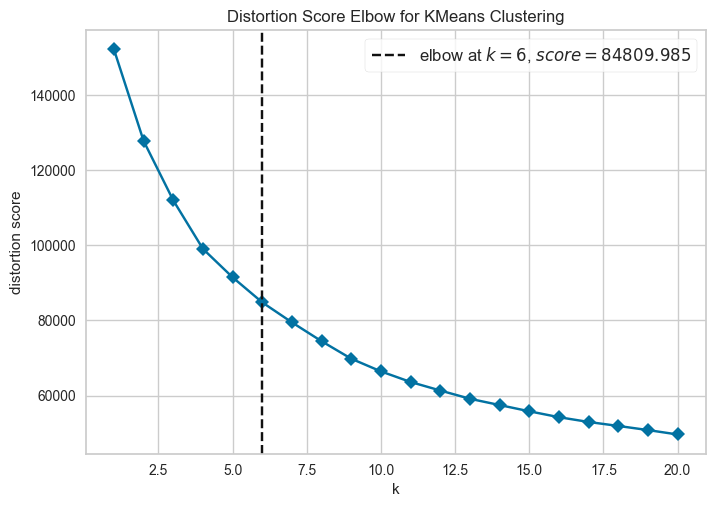

Optimal number of clusters: 6


In [23]:
visualizer = KElbowVisualizer(pipe[1], k=(1,21), timings=False)
visualizer.fit(pipe[0].fit_transform(X))
visualizer.show()
n_clusters = visualizer.elbow_value_
print("Optimal number of clusters:", n_clusters)

In [24]:
# função para logar experimentos no mlflow

def make_experiment(X, model, experiment_name, model_name, run_name, score):

    mlflow.set_tracking_uri('http://127.0.0.1:5000')
    mlflow.set_experiment(experiment_name)


    with mlflow.start_run(run_name=run_name):
            
        mlflow.log_params(model.get_params())
        mlflow.log_param('Features', X.columns.to_list())
        mlflow.log_metric('silhouette_score', score)
        mlflow.sklearn.log_model(model, model_name)
    mlflow.end_run()
    
    print('silhouette_score:',score)

    return print('Iniciando monitoramento do experimento no Mlflow...')

In [25]:
pipe = Pipeline([('scaler', StandardScaler()), ('kmeans', KMeans(n_clusters=4, random_state=42))])
pipe.fit(X)

df['CLUSTER'] = pipe.named_steps['kmeans'].labels_
score = silhouette_score(X, df['CLUSTER'])

experiment_name = 'Segmentação de clientes - cartão de crédito'
model_name = 'Kmeans 4'
date = datetime.now().strftime("%d/%m/%Y %H:%M:%S")
run_name = model_name + ' - ' + date

In [26]:
make_experiment(X=X, model=pipe, experiment_name=experiment_name, model_name=model_name, run_name=run_name, score=score)

silhouette_score: 0.043271487124478
Iniciando monitoramento do experimento no Mlflow...


- Apesar do gráfio apontar 6 como número ótimo de cluster, o score de silhueta indica 4 sendo o melhor número !

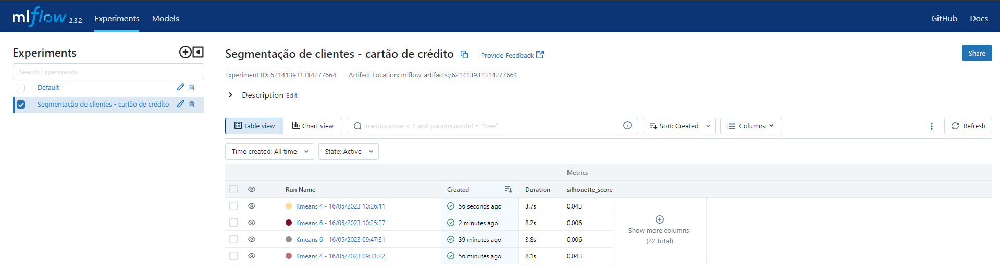

In [27]:
df['CLUSTER'].value_counts()

1    3977
3    3367
2    1197
0     409
Name: CLUSTER, dtype: int64

In [28]:
len(pipe.named_steps['kmeans'].cluster_centers_)

4

In [29]:
cluster_centroids = pd.DataFrame(data = pipe.named_steps['scaler'].inverse_transform(pipe.named_steps['kmeans'].cluster_centers_), columns=[X.columns])

In [30]:
cluster_centroids

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,3551.153623,0.986879,7681.619853,5095.878998,2587.207775,653.638768,0.946418,0.739031,0.788060,0.071290,2.085575,89.359413,9696.943765,7288.738803,1970.476247,0.286707,11.951100
1,1012.658284,0.789924,270.041785,209.937299,60.371441,596.509884,0.170145,0.086301,0.080558,0.114846,2.125471,2.903193,3277.886178,974.260132,535.522678,0.077981,11.446568
2,4602.449793,0.968389,501.862982,320.188797,181.759123,4521.509551,0.287832,0.138911,0.185671,0.484792,14.294904,7.665831,7546.160860,3484.054550,2000.543217,0.034888,11.386800
3,894.907440,0.934734,1236.178934,593.974874,642.478274,210.570622,0.885165,0.297070,0.711842,0.042573,0.790021,22.091773,4213.207677,1332.194227,633.740265,0.269258,11.594595


- Brainstorm:
    - O objetivo é identificar as segmentações de cada cluster.
    - É interessante para o banco identificar agrupamentos que mostrem potênciais oportunidades de aumentar a receita.
    - Vamos interpretar os clusteres e identificar os clientes que podem trazer o melhor retorno financeiro e categorizá-los de acordo aos insigths.
    
- Cluster
    - Vamos buscar:
        - Segmentação Vip 
        - Segmentação Plus  
        - Segmentação Mid  
        - Segmentação Low  

- CLUSTER 2 ( Segmentação Vip ):

    - Possuem uma maior porcentagem de pagamento integral da fatura do cartão de crédito (28%). 
    - Possuem uma maior média de tempo usando nossos serviços bancários(11.95) meses. 
    - Possuem o limite do cartão mais alto (9.696,94).
    - Possuem a maior taxa de transações de compras feitas (89.35).
    - Possuem uma média maior no valor das parcelas feitas (2.587.20).
    - Possuem o maior valor de compra feito em uma única vez (5.095.87).
    - Possuem a maior média de quantidade de compras feita na conta (7681.61).
    
        - **São clientes que compram bastante, pagam as faturas e têm o maior limite de crédito.**
            - Ação: Indicar análise de crédito para estes clientes para verificar qual valor podemos dar.
            - Alavanca: Fazer estes clientes comprarem mais com o cartão e parcelado para ganharmos nos juros. Pois estamos mais assegurados de receber as parcelas integrais. 
        

- CLUSTER 3 ( Segmentação Plus ):
    
    - Possuem a maior média de valor de solicitação de crédito adiantado (4.521.50).
    - Possuem a maior média de saldo restante para compra na conta (4.602).
    - Maior pagamento mínimo feito (2000).
    - Segundo maior limite de crédito médio (7546.16).
    - Usam com bastante frequência o limite do cartão para saque (48%). 
    - Porém possuem a menor taxa de pagamento da fatura (3%).
        - **Grupo de clientes que geram bastante dinheiro para o banco, porém pagam a fatura do cartão com fraquência baixa.**
            - Ação: Indicar analise de crédito para os clientes de forma mais restrita pois eles podem se individar posteriormente.
            - Alavanca: Fazer política de parcelamento das faturas expiradas para estes clientes como forma de recuperar a receita perdida por eles.

- CLUSTER 1 ( Segmentação Mid ):

    - Possuem a segunda maior taxa de pagamento das faturas (26%).
    - Terceiro maior limite de crédito.
    - Menos usam o limite do cartão para saque.
    - Menor valor disponível na conta para compras.
    - Segunda maior média quantidade de compras feitas.
        
        - **Clientes fieis ao pagamento das faturas que parecem ser mais reservados e educados finaceiramente.**
            - Ação: Indicar propostas de marketing para aumentar a frequência de uso do cartão, ofertar cashbacks se bater meta de compras X e etc.
            - Alavanca: fazer campanha para aumentar o uso do cartão.

- CLUSTER 0 ( Segmentação Low ):
    
    - Possuem menor média de compras feitas.
    - Possuem uma conta com saldo pouco atualizado.
    - Efetuam parcelas baixas.
    - Limite de crédito mais baixo
    - Segunda menor taxa de pagamento das faturas
        
        - **Clientes que trazem retorno financeiro mais baixo para o banco. São bastante reservados.**
            
            - Ação: Aumentar limite de crédito de forma gradativa através de gamificação.
            - Alavanca: Oferecer cashback, milhas áerias, desconto em lojas para aumentar o uso do cartão de crédito para estes clientes.

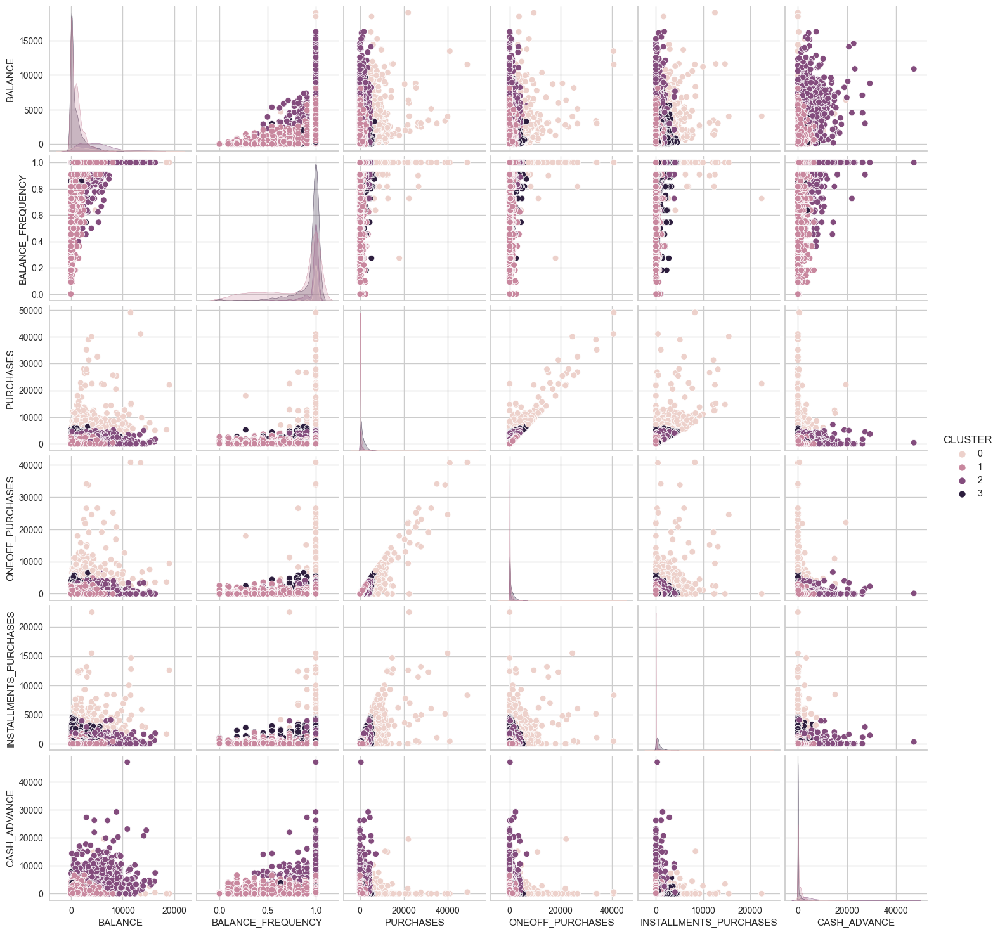

In [31]:
# Visualização de dados
df_viz = pd.concat([df.iloc[:,:6], df['CLUSTER']], axis=1)

sns.pairplot(df_viz, hue="CLUSTER")

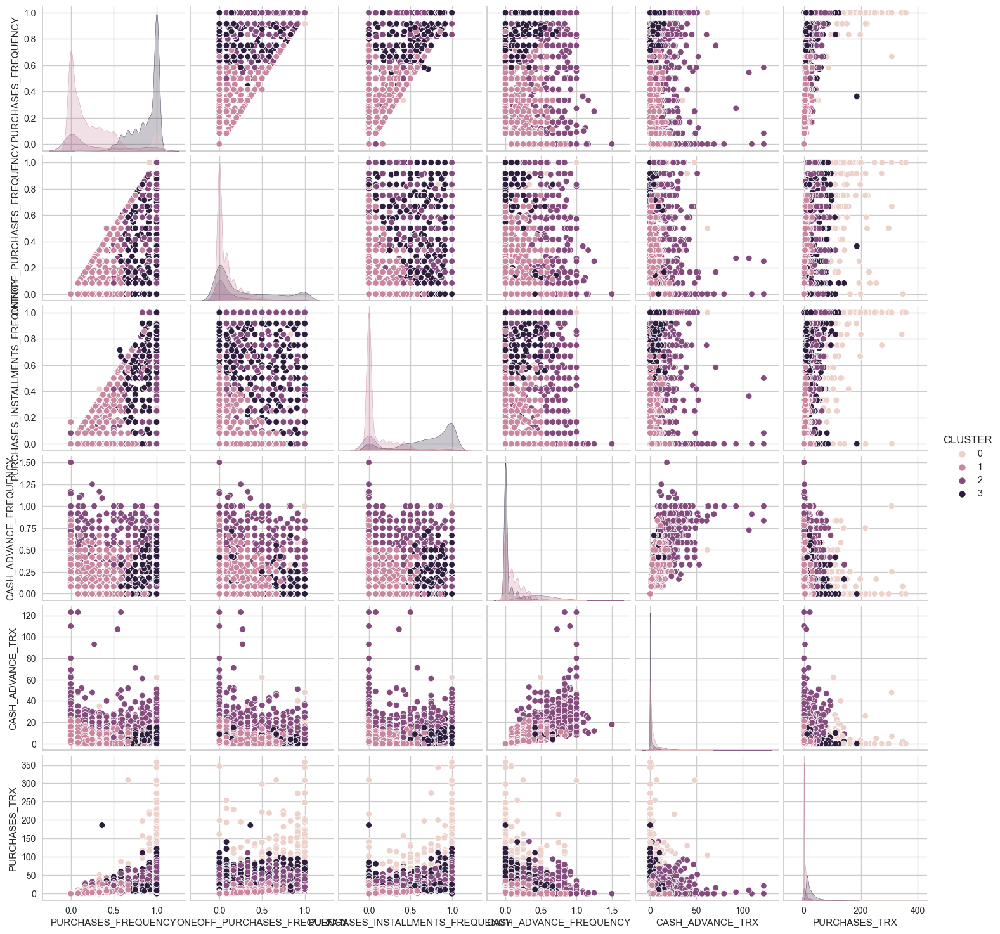

In [32]:
# Visualização de dados
df_viz = pd.concat([df.iloc[:,6:12], df['CLUSTER']], axis=1)
sns.pairplot(df_viz, hue="CLUSTER")

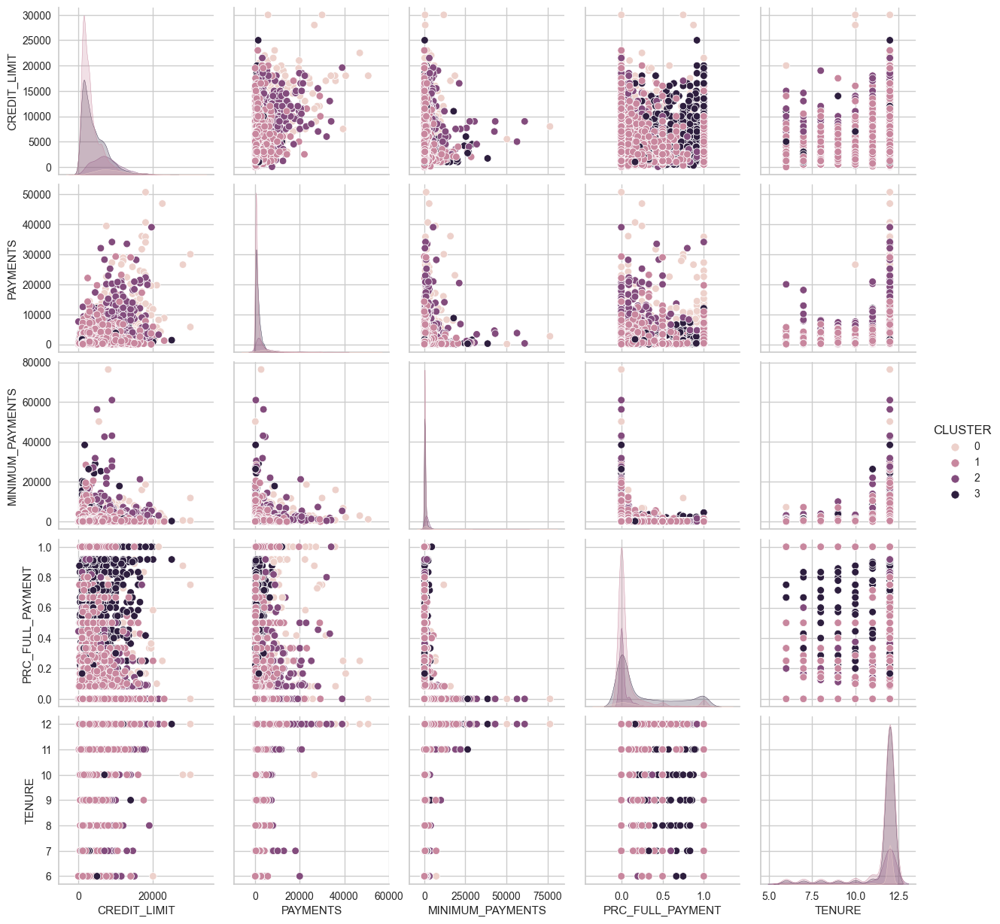

In [33]:
# Visualização de dados
df_viz = pd.concat([df.iloc[:,12:17], df['CLUSTER']], axis=1)
sns.pairplot(df_viz, hue="CLUSTER")

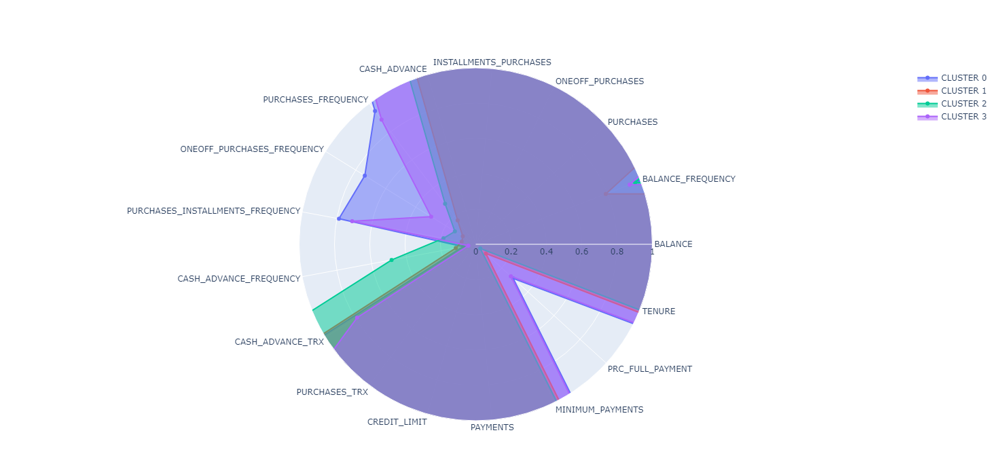

In [37]:
fig = go.Figure()
angles = list(X.columns)

layoutdict = dict(
            radialaxis=dict(
            visible=True,
            range=[0, 1]
            ))

for i in range(4):
    subset = df[df['CLUSTER'] == i]
    data = [np.mean(subset[col]) for col in subset.columns[:-2]]
    data.append(data[0])
    fig.add_trace(go.Scatterpolar(
        r=data,
        theta=angles,
        fill='toself',
        name="CLUSTER " + str(i)))
    
fig.update_layout(
        polar=layoutdict,
        showlegend=True,
        height=700,
        width=1200
        )
fig.show()

In [38]:
# Adicionar PCA para reduzir dimensionalidades

pipe = Pipeline([('scaler', StandardScaler()), ('PCA',PCA(n_components=2)) , ('kmeans', KMeans(n_clusters=4, random_state=42))])
pipe.fit(X)

df['CLUSTER_KMEANS_PCA'] = pipe.named_steps['kmeans'].labels_
score = silhouette_score(X, df['CLUSTER_KMEANS_PCA'])

experiment_name = 'Segmentação de clientes - cartão de crédito'
model_name = 'Kmeans PCA'
date = datetime.now().strftime("%d/%m/%Y %H:%M:%S")
run_name = model_name + ' - ' + date

In [39]:
make_experiment(X=X, model=pipe, experiment_name=experiment_name, model_name=model_name, run_name=run_name, score=score)

silhouette_score: 0.0537761453404143
Iniciando monitoramento do experimento no Mlflow...


In [40]:
df['CLUSTER_KMEANS_PCA'].value_counts()

3    3921
0    3279
1    1246
2     504
Name: CLUSTER_KMEANS_PCA, dtype: int64

In [41]:
data = pipe.named_steps['kmeans'].cluster_centers_

In [42]:
data = pipe.named_steps['PCA'].inverse_transform(data)

In [43]:
data = pipe.named_steps['scaler'].inverse_transform(data)

In [44]:
cluster_centroids = pd.DataFrame(data = data, columns=[X.columns])

In [45]:
cluster_centroids

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,778.925381,0.866981,1707.433898,998.291242,709.596569,-137.101659,0.697493,0.289199,0.546898,0.017753,-0.386998,24.167189,4190.277419,1572.761436,509.090194,0.253671,11.622969
1,4320.052671,0.968731,826.387562,636.492653,189.879991,4145.023807,0.160171,0.136806,0.064018,0.440975,13.193840,7.833377,7037.617339,3857.497558,2110.066341,-0.056362,11.440799
2,3399.823086,1.069604,6329.241389,4105.536394,2224.327405,1311.069588,1.211426,0.725115,0.970465,0.087337,3.205637,72.551057,9697.361658,6855.021010,2007.698020,0.347407,12.164385
3,1104.580806,0.831916,-213.763140,-212.597199,-0.935010,857.248108,0.329996,0.083729,0.229997,0.141690,3.115614,1.564770,3265.910283,529.810344,546.873930,0.112387,11.370259


- CLUSTER 2 Vip
- CLUSTER 1 Plus
- CLUSTER 0 Mid
- CLUSTER 3 Low

In [46]:
# Visualização de dados PCA futuramente
p_componentes = pipe.named_steps['PCA'].transform(X)

In [47]:
pca_df = pd.DataFrame(data = p_componentes, columns=['PCA_1','PCA_2'])
pca_df.head()

,PCA_1,PCA_2
0,6899.284526,9003.715966
1,9921.091128,4363.980974
2,4852.562129,3160.107187
3,30358.059468,13690.588158
4,6980.423990,6852.778873


In [48]:
pca_df.shape

(8950, 2)

In [49]:
len(pipe.named_steps['kmeans'].labels_)

8950

In [50]:
pca_df = pd.concat([pca_df, pd.DataFrame({'CLUSTER PCA':pipe.named_steps['kmeans'].labels_})], axis=1)

In [51]:
pca_df.head()

,PCA_1,PCA_2,CLUSTER PCA
0,6899.284526,9003.715966,2
1,9921.091128,4363.980974,2
2,4852.562129,3160.107187,2
3,30358.059468,13690.588158,2
4,6980.423990,6852.778873,2


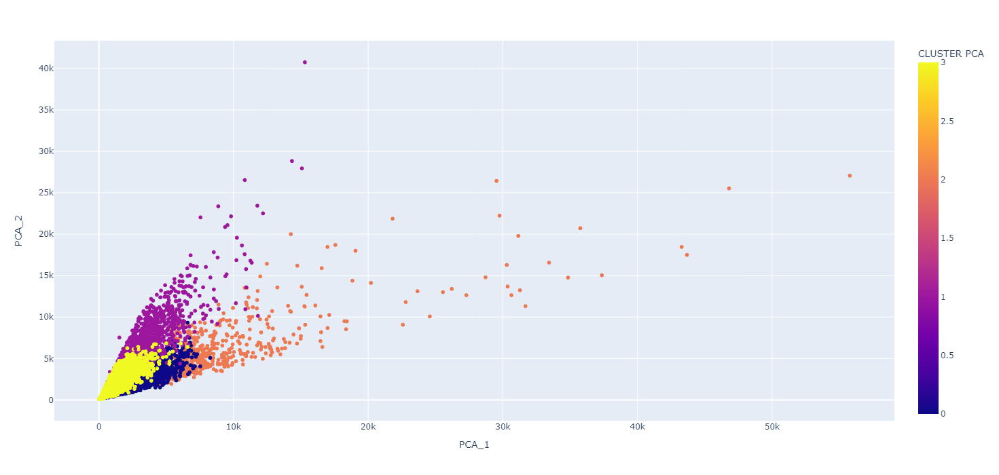

In [52]:
# dataviz
fig = px.scatter(data_frame=pca_df, x='PCA_1', y='PCA_2', color='CLUSTER PCA', height=700, width=1200)
fig.show()

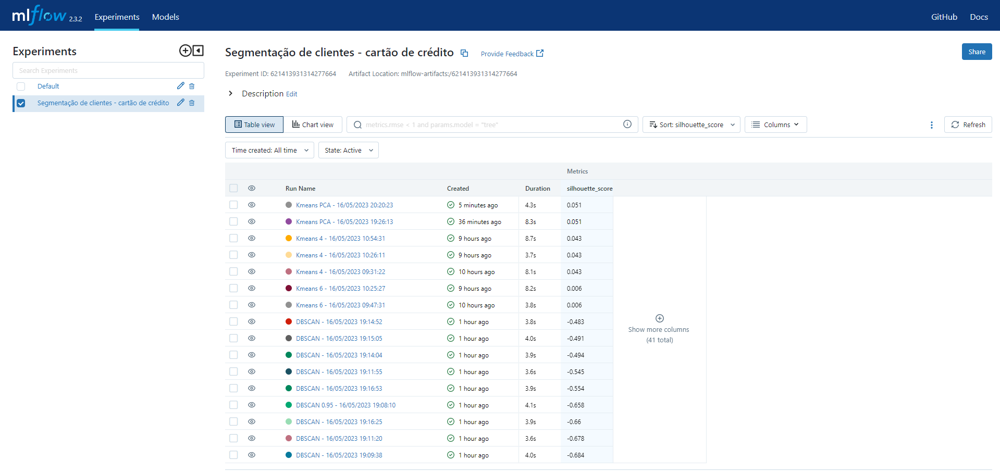

- Houve uma melhora na qualidade dos agrupamentos após aplicar a redução de dimensionalidade !

### DBSCAN

In [53]:
# Pipeline
dbscan = Pipeline([('scaler', StandardScaler()), ('DBSCAN', DBSCAN(eps=0.9, min_samples=4))])

In [54]:
df['CLUSTER_DBSCAN'] = dbscan.fit_predict(X)
score = silhouette_score(X, df['CLUSTER_DBSCAN'])

experiment_name = 'Segmentação de clientes - cartão de crédito'
model_name = 'DBSCAN'
date = datetime.now().strftime("%d/%m/%Y %H:%M:%S")
run_name = model_name + ' - ' + date

In [55]:
dbscan.named_steps['DBSCAN'].labels_

array([-1, -1, -1, ...,  1,  1, -1], dtype=int64)

In [56]:
make_experiment(X=X, model=dbscan, experiment_name=experiment_name, model_name=model_name, run_name=run_name, score=score)

2023/05/16 21:46:17 WARNING mlflow.sklearn: Model was missing function: predict. Not logging python_function flavor!


silhouette_score: -0.5538961095040926
Iniciando monitoramento do experimento no Mlflow...


In [57]:
df['CLUSTER_DBSCAN'].value_counts()

 1     5266
-1     3496
 5       34
 7       24
 24       9
 4        7
 30       7
 10       6
 31       5
 3        5
 25       4
 28       4
 29       4
 23       4
 21       4
 26       4
 27       4
 15       4
 13       4
 0        4
 11       4
 20       4
 14       4
 8        4
 12       4
 17       4
 16       4
 6        4
 2        4
 32       4
 19       3
 18       3
 9        3
 22       2
Name: CLUSTER_DBSCAN, dtype: int64

- Bem ruim os resultados para esta abordagem.

## Carga

In [58]:
df.head()

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,...,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,CLUSTER_KMEANS_PCA,SEGMENTATION,CLUSTER,CLUSTER_DBSCAN
CUST_ID,,,,,,,,,,,,,,,,,,,,,
C15490,8419.740,1.0,3050.48,1475.56,1574.92,2127.49,1.000000,1.000000,1.000000,0.25,...,67,12300.0,3298.74,4239.300,0.000000,12,2,Vip,0,-1
C13195,725.529,1.0,8754.59,8636.73,117.86,0.00,1.000000,1.000000,0.250000,0.00,...,116,4000.0,8648.30,195.873,0.916667,12,2,Vip,0,-1
C13241,292.689,1.0,2815.82,2047.65,768.17,0.00,1.000000,1.000000,1.000000,0.00,...,71,7000.0,4382.77,206.099,0.500000,12,2,Vip,3,-1
C10529,2643.340,1.0,26402.40,22257.40,4145.00,0.00,1.000000,1.000000,0.333333,0.00,...,114,16500.0,24529.30,534.032,1.000000,12,2,Vip,0,-1
C14918,4929.760,1.0,4939.10,4939.10,0.00,2365.84,0.666667,0.666667,0.000000,0.25,...,309,6000.0,3952.19,5234.370,0.000000,12,2,Vip,0,-1


In [59]:
# dropar colunas irrelevantes
df.drop(['CLUSTER','CLUSTER_DBSCAN'],axis = 1, inplace=True)

In [60]:
df.head()

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,CLUSTER_KMEANS_PCA,SEGMENTATION
CUST_ID,,,,,,,,,,,,,,,,,,,
C15490,8419.740,1.0,3050.48,1475.56,1574.92,2127.49,1.000000,1.000000,1.000000,0.25,5,67,12300.0,3298.74,4239.300,0.000000,12,2,Vip
C13195,725.529,1.0,8754.59,8636.73,117.86,0.00,1.000000,1.000000,0.250000,0.00,0,116,4000.0,8648.30,195.873,0.916667,12,2,Vip
C13241,292.689,1.0,2815.82,2047.65,768.17,0.00,1.000000,1.000000,1.000000,0.00,0,71,7000.0,4382.77,206.099,0.500000,12,2,Vip
C10529,2643.340,1.0,26402.40,22257.40,4145.00,0.00,1.000000,1.000000,0.333333,0.00,0,114,16500.0,24529.30,534.032,1.000000,12,2,Vip
C14918,4929.760,1.0,4939.10,4939.10,0.00,2365.84,0.666667,0.666667,0.000000,0.25,7,309,6000.0,3952.19,5234.370,0.000000,12,2,Vip


In [61]:
df['CLUSTER_KMEANS_PCA'].dtype

dtype('int32')

In [62]:
# adicionar coluna de segmentação 
# CLUSTER 2 Vip
# CLUSTER 1 Plus
# CLUSTER 0 Mid
# CLUSTER 3 Low

df['SEGMENTATION'] = df['CLUSTER_KMEANS_PCA'].map({2:'Vip', 1:'Plus', 0:'Mid', 3:'Low',})

In [63]:
df.head()

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,CLUSTER_KMEANS_PCA,SEGMENTATION
CUST_ID,,,,,,,,,,,,,,,,,,,
C15490,8419.740,1.0,3050.48,1475.56,1574.92,2127.49,1.000000,1.000000,1.000000,0.25,5,67,12300.0,3298.74,4239.300,0.000000,12,2,Vip
C13195,725.529,1.0,8754.59,8636.73,117.86,0.00,1.000000,1.000000,0.250000,0.00,0,116,4000.0,8648.30,195.873,0.916667,12,2,Vip
C13241,292.689,1.0,2815.82,2047.65,768.17,0.00,1.000000,1.000000,1.000000,0.00,0,71,7000.0,4382.77,206.099,0.500000,12,2,Vip
C10529,2643.340,1.0,26402.40,22257.40,4145.00,0.00,1.000000,1.000000,0.333333,0.00,0,114,16500.0,24529.30,534.032,1.000000,12,2,Vip
C14918,4929.760,1.0,4939.10,4939.10,0.00,2365.84,0.666667,0.666667,0.000000,0.25,7,309,6000.0,3952.19,5234.370,0.000000,12,2,Vip


In [64]:
df_load = df.sort_values(by='SEGMENTATION', ascending=False)

In [65]:
df_load.reset_index(inplace=True)

In [66]:
df_load.head()

,CUST_ID,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,CLUSTER_KMEANS_PCA,SEGMENTATION
0,C15490,8419.740,1.0,3050.48,1475.56,1574.92,2127.490,1.0,1.000000,1.000000,0.250000,5,67,12300.0,3298.740,4239.300,0.000000,12,2,Vip
1,C11330,505.313,1.0,4471.79,2875.13,1596.66,298.025,1.0,1.000000,0.916667,0.083333,1,74,14500.0,4393.040,188.516,0.833333,12,2,Vip
2,C10142,2494.870,1.0,5491.79,1390.50,4101.29,0.000,1.0,0.500000,1.000000,0.000000,0,52,17000.0,1015.310,615.924,0.000000,12,2,Vip
3,C14494,3277.090,1.0,3936.51,3249.14,687.37,517.563,1.0,0.666667,0.916667,0.166667,2,57,10000.0,2183.770,812.767,0.000000,12,2,Vip
4,C11356,2415.410,1.0,3313.65,1938.44,1375.21,843.735,1.0,0.666667,1.000000,0.416667,10,55,8500.0,858.811,582.753,0.000000,12,2,Vip


In [67]:
# Formatar tipos de dados do banco de acordo aos dados
dtypes = {
    'CLUSTER_KMEANS_PCA': sqlalchemy.types.Integer(),
    'SEGMENTATION': sqlalchemy.types.VARCHAR(length=5),
}

In [68]:
# Carga do csv para o banco MySQL com integração direta do Pandas
df_load.to_sql(name='customer_credit_card',
          con=engine,
          if_exists='replace',
          index=False,
          dtype=dtypes)

8950

In [69]:
# fechar conexão com o banco
engine.dispose()